In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Reconhecimento de gestoes e ações

## Carregamento da imagem

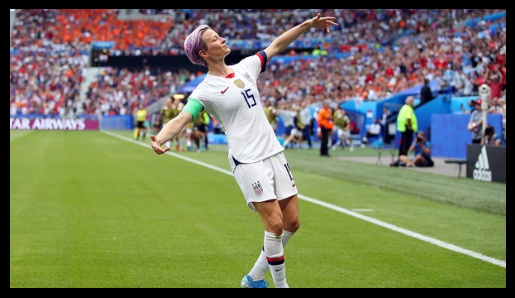

In [2]:
imagem = cv2.imread('./megan.jpg')
plt.imshow(cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [3]:
imagem.shape

(337, 600, 3)

In [4]:
337 * 600 * 3

606600

In [5]:
type(imagem)

numpy.ndarray

In [6]:
# Mean subtraction: https://www.pyimagesearch.com/2017/11/06/deep-learning-opencvs-blobfromimage-works/
imagem_blob = cv2.dnn.blobFromImage(image=imagem, scalefactor=1.0 / 255, size=(imagem.shape[1], imagem.shape[0]),
                                    swapRB=True, crop=False)

imagem_blob.shape  # 1 inicial batch

(1, 3, 337, 600)

## Carregamento da rede neural pré-treinada

- Caffe Deep Learning framework: https://caffe.berkeleyvision.org/

In [5]:
network = cv2.dnn.readNetFromCaffe('./pose_deploy_linevec_faster_4_stages.prototxt',
                                   './pose_iter_160000.caffemodel')

In [8]:
network.getLayerNames()

('conv1_1',
 'relu1_1',
 'conv1_2',
 'relu1_2',
 'pool1_stage1',
 'conv2_1',
 'relu2_1',
 'conv2_2',
 'relu2_2',
 'pool2_stage1',
 'conv3_1',
 'relu3_1',
 'conv3_2',
 'relu3_2',
 'conv3_3',
 'relu3_3',
 'conv3_4',
 'relu3_4',
 'pool3_stage1',
 'conv4_1',
 'relu4_1',
 'conv4_2',
 'relu4_2',
 'conv4_3_CPM',
 'relu4_3_CPM',
 'conv4_4_CPM',
 'relu4_4_CPM',
 'conv5_1_CPM_L1',
 'relu5_1_CPM_L1',
 'conv5_1_CPM_L2',
 'relu5_1_CPM_L2',
 'conv5_2_CPM_L1',
 'relu5_2_CPM_L1',
 'conv5_2_CPM_L2',
 'relu5_2_CPM_L2',
 'conv5_3_CPM_L1',
 'relu5_3_CPM_L1',
 'conv5_3_CPM_L2',
 'relu5_3_CPM_L2',
 'conv5_4_CPM_L1',
 'relu5_4_CPM_L1',
 'conv5_4_CPM_L2',
 'relu5_4_CPM_L2',
 'conv5_5_CPM_L1',
 'conv5_5_CPM_L2',
 'concat_stage2',
 'Mconv1_stage2_L1',
 'Mrelu1_stage2_L1',
 'Mconv1_stage2_L2',
 'Mrelu1_stage2_L2',
 'Mconv2_stage2_L1',
 'Mrelu2_stage2_L1',
 'Mconv2_stage2_L2',
 'Mrelu2_stage2_L2',
 'Mconv3_stage2_L1',
 'Mrelu3_stage2_L1',
 'Mconv3_stage2_L2',
 'Mrelu3_stage2_L2',
 'Mconv4_stage2_L1',
 'Mrelu4_sta

## Previsão dos pontos corporais

In [9]:
network.setInput(imagem_blob)
output = network.forward()

In [10]:
output.shape

(1, 44, 43, 75)

In [11]:
posicao_largura = output.shape[3]
posicao_altura = output.shape[2]

In [12]:
posicao_largura, posicao_altura

(75, 43)

In [19]:
# minMaxLoc: https://docs.opencv.org/master/d2/de8/group__core__array.html#gab473bf2eb6d14ff97e89b355dac20707
numero_pontos = 15
pontos = []
threshold = 0.1
for i in range(numero_pontos):
    mapa_confianca = output[0, i, :, :]
    # print(mapa_confianca)
    # print(len(mapa_confianca))
    _, confianca, _, ponto = cv2.minMaxLoc(mapa_confianca)
    # print(confianca)
    # print(ponto)
    x = int(imagem.shape[1] * (ponto[0] / posicao_largura))
    y = int(imagem.shape[0] * (ponto[1] / posicao_altura))
    # print(x, y)
    if confianca > threshold:
        cv2.circle(imagem, (x, y), 5, (0, 255, 0), thickness=-1)
        cv2.putText(imagem, '{}'.format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255))
        pontos.append((x, y))
    else:
        pontos.append(None)

In [20]:
pontos

[(224, 23),
 (248, 62),
 (232, 94),
 (208, 125),
 (176, 148),
 (280, 70),
 (312, 47),
 (352, 15),
 (288, 180),
 (320, 250),
 (320, 321),
 (312, 172),
 (336, 250),
 (296, 305),
 (280, 125)]

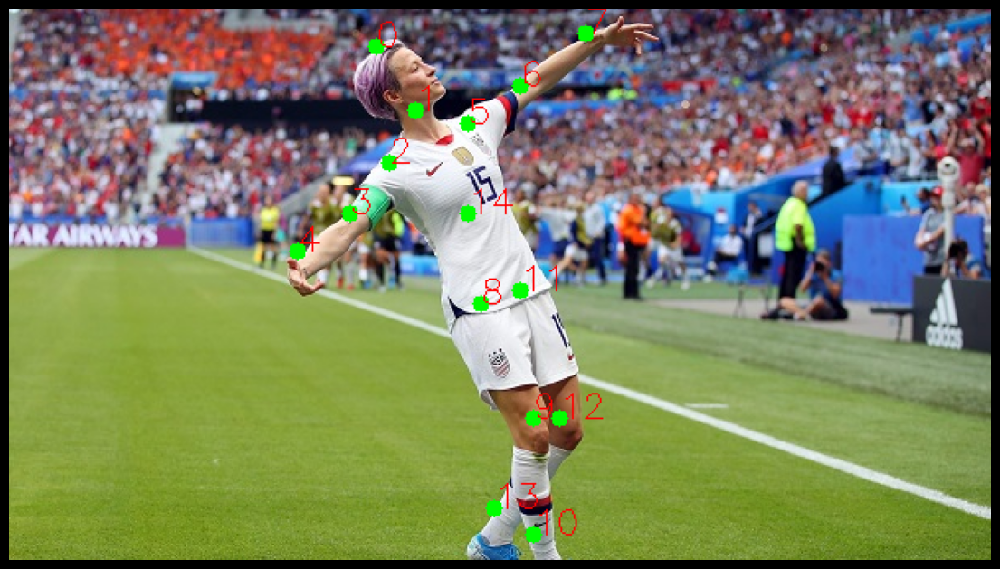

In [21]:
plt.figure(figsize=(14,10))
plt.imshow(cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

In [34]:
ponto_conexoes = [[0,1], [1,2], [2,3], [3,4], [1,5], [5,6], [6,7], [1, 14],
                  [14,8], [8,9], [9,10], [14,11], [11,12],[12,13]]

In [24]:
ponto_conexoes

[[0, 1],
 [1, 2],
 [2, 3],
 [3, 4],
 [1, 5],
 [5, 6],
 [6, 7],
 [1, 14],
 [14, 8],
 [8, 9],
 [9, 10],
 [14, 11],
 [11, 12],
 [12, 13]]

In [25]:
for conexao in ponto_conexoes:
  #print(conexao)
  parteA = conexao[0]
  parteB = conexao[1]
  #print(parteA, parteB)
  if pontos[parteA] and pontos[parteB]:
    cv2.line(imagem, pontos[parteA], pontos[parteB], (255,0,0))

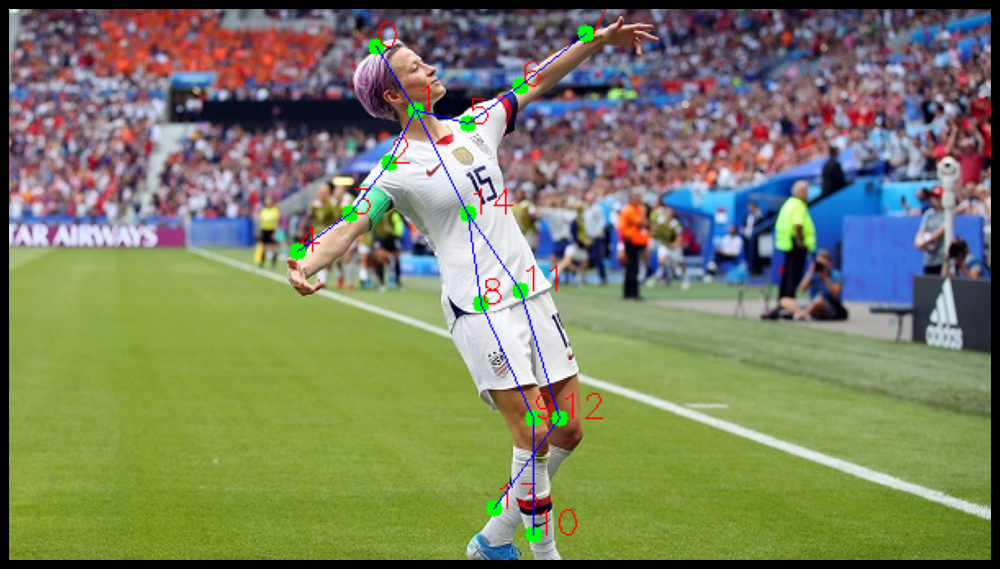

In [26]:
plt.figure(figsize=(14,10))
plt.imshow(cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

## Detecção de movimentos (braços a cima da cabeça)

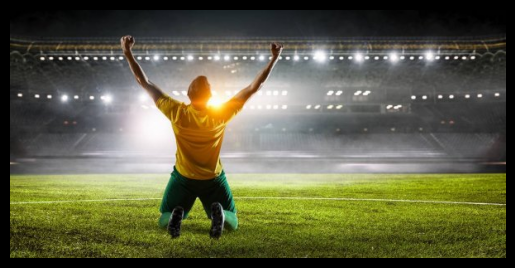

In [3]:
imagem = cv2.imread('./player.jpg')
plt.imshow(cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

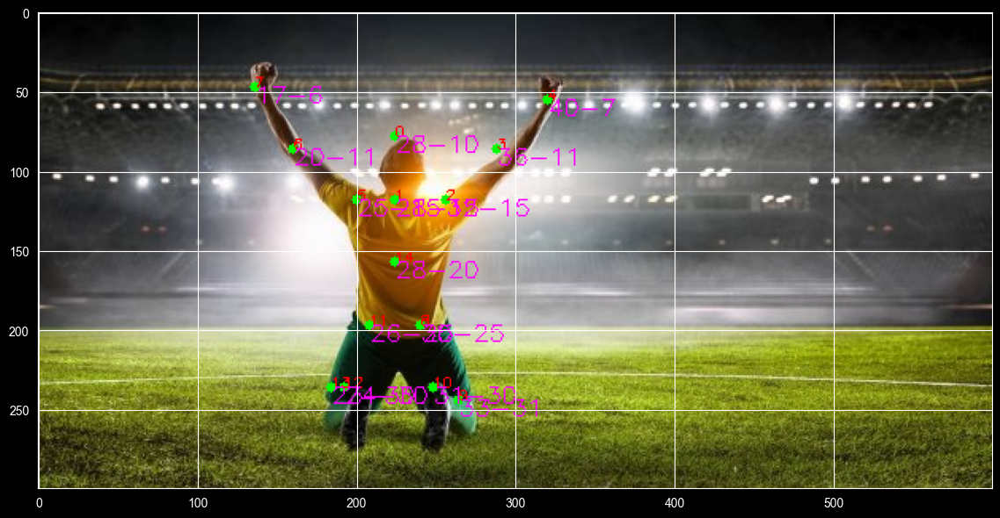

In [6]:
imagem2 = cv2.imread('./player.jpg')
imagem_blob2 = cv2.dnn.blobFromImage(image = imagem2, scalefactor = 1.0 / 255, size = (imagem2.shape[1], imagem2.shape[0]))
network.setInput(imagem_blob2)
output2 = network.forward()
posicao_largura = output2.shape[3]
posicao_altura = output2.shape[2]
numero_pontos = 15
pontos = []
threshold = 0.1
for i in range(numero_pontos):
  mapa_confianca = output2[0, i, :, :]
  _, confianca, _, ponto = cv2.minMaxLoc(mapa_confianca)
  x = int((imagem2.shape[1] * ponto[0]) / posicao_largura)
  y = int((imagem2.shape[0] * ponto[1]) / posicao_altura)

  if confianca > threshold:
    cv2.circle(imagem2, (x, y), 3, (0,255,0), thickness = -1)
    cv2.putText(imagem2, "{}".format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, .3, (0, 0, 255))
    cv2.putText(imagem2, '{}-{}'.format(ponto[0], ponto[1]), (x, y + 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,255))
    pontos.append((x, y))
  else:
    pontos.append(None)

plt.figure(figsize = [14,10])
plt.imshow(cv2.cvtColor(imagem2, cv2.COLOR_BGR2RGB));

In [7]:
def verifica_bracos_acima(pontos):
  cabeca, pulso_direito, pulso_esquerdo = 0, 0, 0
  for i, ponto in enumerate(pontos):
    #print(i, ponto)
    if i == 0:
      cabeca = ponto[1]
    elif i == 4:
      pulso_direito = ponto[1]
    elif i == 7:
      pulso_esquerdo = ponto[1]

  #print(cabeca, pulso_direito, pulso_esquerdo)
  if pulso_direito < cabeca and pulso_esquerdo < cabeca:
    return True
  else:
    return False

In [8]:
verifica_bracos_acima(pontos)

True

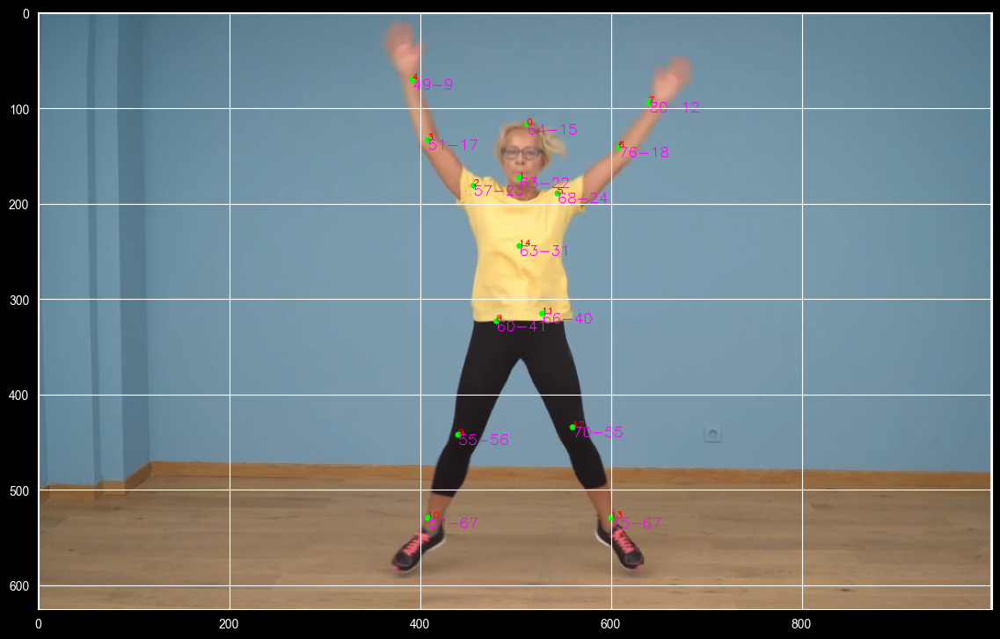

In [9]:
imagem2 = cv2.imread('./jump.jpg')
imagem_blob2 = cv2.dnn.blobFromImage(image = imagem2, scalefactor = 1.0 / 255, size = (imagem2.shape[1], imagem2.shape[0]))
network.setInput(imagem_blob2)
output2 = network.forward()
posicao_largura = output2.shape[3]
posicao_altura = output2.shape[2]
numero_pontos = 15
pontos = []
threshold = 0.1
for i in range(numero_pontos):
  mapa_confianca = output2[0, i, :, :]
  _, confianca, _, ponto = cv2.minMaxLoc(mapa_confianca)
  x = int((imagem2.shape[1] * ponto[0]) / posicao_largura)
  y = int((imagem2.shape[0] * ponto[1]) / posicao_altura)

  if confianca > threshold:
    cv2.circle(imagem2, (x, y), 3, (0,255,0), thickness = -1)
    cv2.putText(imagem2, "{}".format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, .3, (0, 0, 255))
    cv2.putText(imagem2, '{}-{}'.format(ponto[0], ponto[1]), (x, y + 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,0,255))
    pontos.append((x, y))
  else:
    pontos.append(None)

plt.figure(figsize = [14,10])
plt.imshow(cv2.cvtColor(imagem2, cv2.COLOR_BGR2RGB));

In [10]:
def verifica_pernas_afastadas(pontos):
  quadril_esquerdo, quadril_direito = 0, 0
  tornozelo_esquerdo, tornozelo_direito = 0, 0

  for i, ponto in enumerate(pontos):
    if i == 11:
      quadril_esquerdo = ponto[0]
    elif i == 8:
      quadril_direito = ponto[0]
    elif i == 13:
      tornozelo_esquerdo = ponto[0]
    elif i == 10:
      tornozelo_direito = ponto[0]

  if (tornozelo_esquerdo > quadril_esquerdo) and (tornozelo_direito < quadril_direito):
    return True
  else:
    return False

In [11]:
verifica_pernas_afastadas(pontos)

True

## Braços acima da cabeça em vídeos

- VideoWriter_fourcc: https://www.programcreek.com/python/example/89348/cv2.VideoWriter_fourcc

In [33]:
video = './gesture1.mp4'
captura = cv2.VideoCapture(video)
conectado, frame = captura.read()
print(conectado, frame.shape)

True (1080, 808, 3)


In [31]:
resultado = './gesture1_result.mp4'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
salvar_video = cv2.VideoWriter(resultado, fourcc, 10, (frame.shape[1], frame.shape[0]))

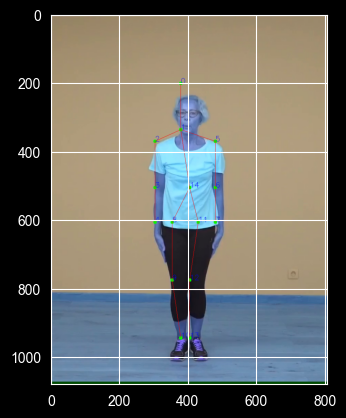

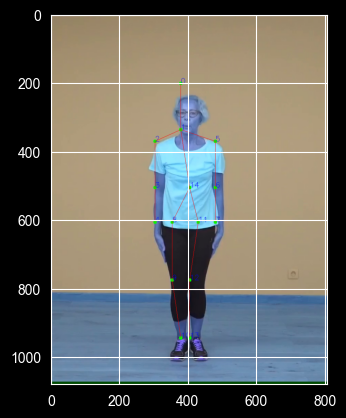

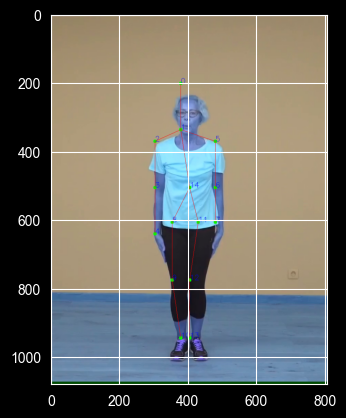

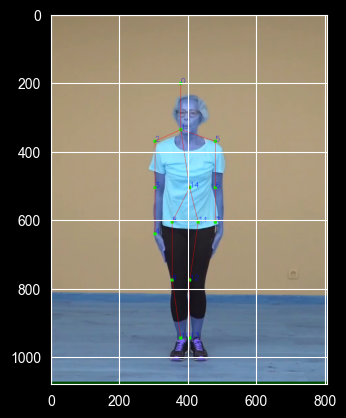

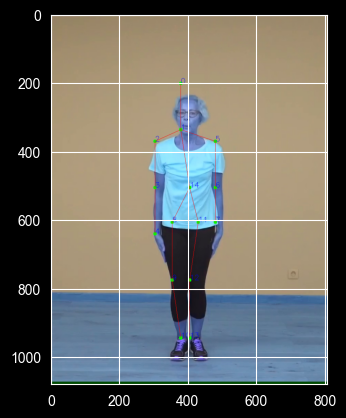

...

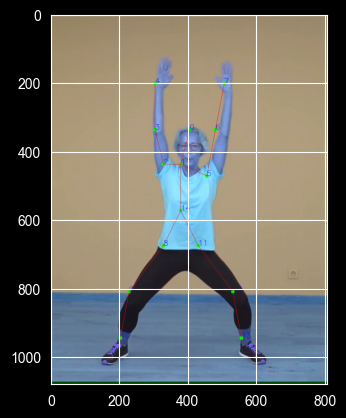

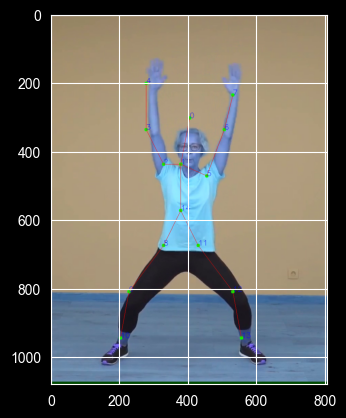

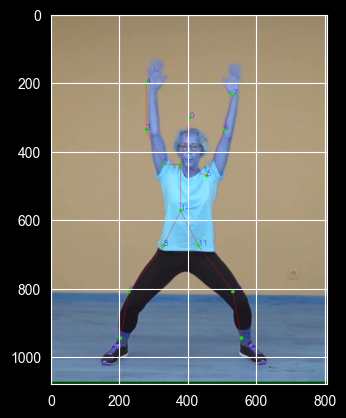

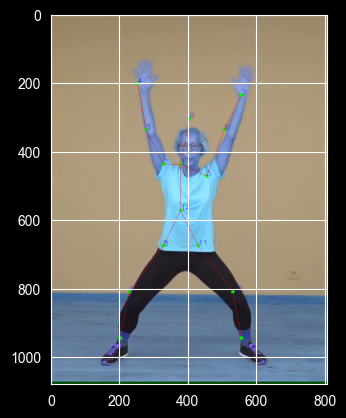

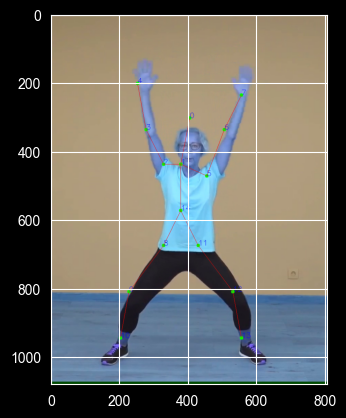

Processamento concluído!


In [35]:
threshold = 0.1
while cv2.waitKey(1) < 0:
  conectado, frame = captura.read()

  if not conectado:
    break

  imagem_blob = cv2.dnn.blobFromImage(image = frame, scalefactor = 1.0 / 255, size = (256, 256))
  network.setInput(imagem_blob)
  output = network.forward()
  posicao_largura = output.shape[2]
  posicao_altura = output.shape[3]

  numero_pontos = 15
  pontos = []
  for i in range(numero_pontos):
    mapa_confianca = output[0, i, :, :]
    _, confianca, _, ponto = cv2.minMaxLoc(mapa_confianca)
    x = int((frame.shape[1] * ponto[0]) / posicao_largura)
    y = int((frame.shape[0] * ponto[1]) / posicao_altura)
    if confianca > threshold:
      cv2.circle(frame, (x, y), 5, (0,255,0), thickness = -1)
      cv2.putText(frame, "{}".format(i), (x, y), cv2.FONT_HERSHEY_SIMPLEX, .7, (0, 0, 255))
      pontos.append((x, y))
    else:
      pontos.append(None)

  for conexao in ponto_conexoes:
    parteA = conexao[0]
    parteB = conexao[1]
    if pontos[parteA] and pontos[parteB]:
      cv2.line(frame, pontos[parteA], pontos[parteB], (255,0,0))

  if verifica_bracos_acima(pontos) == True and verifica_pernas_afastadas == True:
    cv2.putText(frame, 'Completo!', (50,200), cv2.FONT_HERSHEY_COMPLEX, 3,  (0,0,255))

  plt.imshow(frame)
  plt.show()
  salvar_video.write(frame)
salvar_video.release()
print('Processamento concluído!')